<a href="https://colab.research.google.com/github/saurabhgupta18891/Text-Classification-RNN/blob/master/Unsupervised_Text_Classification_word2vec_kmeans_smote.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing Necessary Libraries

In [ ]:
import os
import pandas as pd
import re
#import preprocessor as p

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [ ]:
import pandas as pd
import numpy as np
np.random.seed(1337)
from keras import Sequential
from keras.utils import Sequence
from keras.layers import LSTM, Dense, Masking
import numpy as np
import keras
from keras.utils import np_utils
from keras import optimizers
from keras.models import Sequential, Model
from keras.layers import Embedding, Dense, Input, concatenate, Layer, Lambda, Dropout, Activation
import datetime
from datetime import datetime
from keras.callbacks import ModelCheckpoint, EarlyStopping, Callback, TensorBoard
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import optimizers
from tensorflow.keras import metrics
from tensorflow.keras import losses

In [ ]:
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import SMOTENC
from imblearn.over_sampling import SMOTEN

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID";
os.environ["CUDA_VISIBLE_DEVICES"]="0";

# Loading The Data

In [ ]:
#train_raw = pd.read_csv(r'C:\Users\Saurabh\OneDrive - R Systems International Ltd\Desktop\Text-Classification\rows.csv\consumer_complaints.csv')
# # train_raw.head()
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
train_raw=pd.read_csv('/content/gdrive/MyDrive/consumer_complaints.csv')

/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning: Columns (4,5,6,11,16) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
train_raw.head()

,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
0,05/10/2019,Checking or savings account,Checking account,Managing an account,Problem using a debit or ATM card,NaN,NaN,NAVY FEDERAL CREDIT UNION,FL,328XX,Older American,NaN,Web,05/10/2019,In progress,Yes,NaN,3238275
1,05/10/2019,Checking or savings account,Other banking product or service,Managing an account,Deposits and withdrawals,NaN,NaN,BOEING EMPLOYEES CREDIT UNION,WA,98204,NaN,NaN,Referral,05/10/2019,Closed with explanation,Yes,NaN,3238228
2,05/10/2019,Debt collection,Payday loan debt,Communication tactics,Frequent or repeated calls,NaN,NaN,CURO Intermediate Holdings,TX,751XX,NaN,NaN,Web,05/10/2019,Closed with explanation,Yes,NaN,3237964
3,05/10/2019,"Credit reporting, credit repair services, or o...",Credit reporting,Incorrect information on your report,Old information reappears or never goes away,NaN,NaN,Ad Astra Recovery Services Inc,LA,708XX,NaN,NaN,Web,05/10/2019,Closed with explanation,Yes,NaN,3238479
4,05/10/2019,Checking or savings account,Checking account,Managing an account,Banking errors,NaN,NaN,ALLY FINANCIAL INC.,AZ,85205,NaN,NaN,Postal mail,05/10/2019,In progress,Yes,NaN,3238460


# Preprocessing Data

Select non null:

In [ ]:
train_raw = train_raw[train_raw["Consumer complaint narrative"].notnull()]
train_raw.shape

(383564, 18)

In [ ]:
train_raw.isnull().sum()

Date received                        0
Product                              0
Sub-product                      52173
Issue                                0
Sub-issue                       113673
Consumer complaint narrative         0
Company public response         200884
Company                              0
State                             1386
ZIP code                         88777
Tags                            317319
Consumer consent provided?           0
Submitted via                        0
Date sent to company                 0
Company response to consumer         4
Timely response?                     0
Consumer disputed?              219488
Complaint ID                         0
dtype: int64

<AxesSubplot:ylabel='Frequency'>

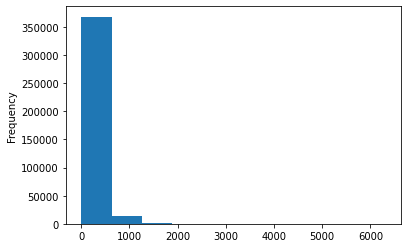

In [ ]:
train_raw["Consumer complaint narrative"].apply(lambda x: len(x.split())).plot(kind='hist')

In [ ]:
train_raw['len_txt'] =train_raw["Consumer complaint narrative"].apply(lambda x: len(x.split()))
train_raw.describe()

,Complaint ID,len_txt
count,3.835640e+05,383564.000000
mean,2.440054e+06,196.822382
std,5.316289e+05,211.063970
min,1.290155e+06,1.000000
25%,2.027031e+06,71.000000
50%,2.580564e+06,136.000000
75%,2.881326e+06,249.000000
max,3.189109e+06,6314.000000


In [ ]:
train_raw.shape

(383564, 19)

Select only the row with number of words greater than 250:

In [ ]:
train_raw = train_raw[train_raw.len_txt >249]
train_raw.shape

(95534, 19)

In [ ]:
train_raw = train_raw[["Consumer complaint narrative", 'Product']]
train_raw.reset_index(inplace=True, drop=True)
train_raw.head()

,Consumer complaint narrative,Product
0,The reason for my writing is to inform you tha...,"Credit reporting, credit repair services, or o..."
1,YOUR COMPLAINT I am disputing the debt owed to...,Debt collection
2,There's alot of inaccurate information constan...,"Credit reporting, credit repair services, or o..."
3,XX/XX/XXXX - called Rushmore Loan Management S...,Debt collection
4,I contacted transunion and XXXX about an acco...,"Credit reporting, credit repair services, or o..."


In [ ]:
train_raw["Product"].unique()

array(['Credit reporting, credit repair services, or other personal consumer reports',
       'Debt collection', 'Credit card or prepaid card', 'Mortgage',
       'Checking or savings account', 'Vehicle loan or lease',
       'Money transfer, virtual currency, or money service',
       'Student loan', 'Payday loan, title loan, or personal loan',
       'Bank account or service', 'Consumer Loan', 'Prepaid card',
       'Credit reporting', 'Credit card', 'Money transfers',
       'Other financial service', 'Payday loan', 'Virtual currency'],
      dtype=object)

Group similar products

In [ ]:
train_raw.loc[train_raw['Product'] == 'Credit reporting', 'Product'] = 'Credit reporting, credit repair services, or other personal consumer reports'
train_raw.loc[train_raw['Product'] == 'Credit card', 'Product'] = 'Credit card or prepaid card'
train_raw.loc[train_raw['Product'] == 'Prepaid card', 'Product'] = 'Credit card or prepaid card'
train_raw.loc[train_raw['Product'] == 'Payday loan', 'Product'] = 'Payday loan, title loan, or personal loan'
train_raw.loc[train_raw['Product'] == 'Virtual currency', 'Product'] = 'Money transfer, virtual currency, or money service'


In [ ]:
train_raw["Product"].unique()

array(['Credit reporting, credit repair services, or other personal consumer reports',
       'Debt collection', 'Credit card or prepaid card', 'Mortgage',
       'Checking or savings account', 'Vehicle loan or lease',
       'Money transfer, virtual currency, or money service',
       'Student loan', 'Payday loan, title loan, or personal loan',
       'Bank account or service', 'Consumer Loan', 'Money transfers',
       'Other financial service'], dtype=object)

In [ ]:
train_raw["Product"].value_counts().head(10)

Mortgage                                                                        22713
Credit reporting, credit repair services, or other personal consumer reports    19170
Debt collection                                                                 15530
Credit card or prepaid card                                                     12927
Student loan                                                                     7125
Bank account or service                                                          5046
Checking or savings account                                                      4573
Consumer Loan                                                                    2802
Vehicle loan or lease                                                            2091
Money transfer, virtual currency, or money service                               1559
Name: Product, dtype: int64

In [ ]:
train_raw=train_raw[train_raw["Product"].isin(["Mortgage","Credit reporting, credit repair services, or other personal consumer reports","Debt collection","Credit card or prepaid card"
,"Student loan"                                                 
,"Bank account or service"                                                          
,"Checking or savings account"                                                      
,"Consumer Loan"                                                                    
,"Vehicle loan or lease"                                                            
,"Money transfer, virtual currency, or money service"])]

In [ ]:
train_raw.head()

,Consumer complaint narrative,Product
0,The reason for my writing is to inform you tha...,"Credit reporting, credit repair services, or o..."
1,YOUR COMPLAINT I am disputing the debt owed to...,Debt collection
2,There's alot of inaccurate information constan...,"Credit reporting, credit repair services, or o..."
3,XX/XX/XXXX - called Rushmore Loan Management S...,Debt collection
4,I contacted transunion and XXXX about an acco...,"Credit reporting, credit repair services, or o..."


In [ ]:
for l in np.unique(train_raw['Product']):
    print(l)

Bank account or service
Checking or savings account
Consumer Loan
Credit card or prepaid card
Credit reporting, credit repair services, or other personal consumer reports
Debt collection
Money transfer, virtual currency, or money service
Mortgage
Student loan
Vehicle loan or lease


<AxesSubplot:>

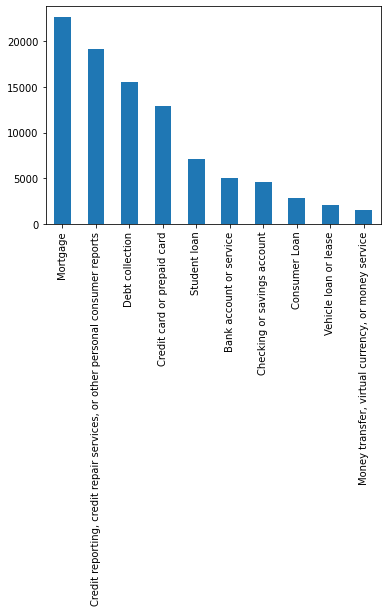

In [ ]:
train_raw['Product'].value_counts().sort_values(ascending=False).plot(kind='bar')

In [ ]:
train_raw=train_raw.rename(columns = {'Consumer complaint narrative':'text', 'Product':'label'})
train_raw.head(10)

,text,label
0,The reason for my writing is to inform you tha...,"Credit reporting, credit repair services, or o..."
1,YOUR COMPLAINT I am disputing the debt owed to...,Debt collection
2,There's alot of inaccurate information constan...,"Credit reporting, credit repair services, or o..."
3,XX/XX/XXXX - called Rushmore Loan Management S...,Debt collection
4,I contacted transunion and XXXX about an acco...,"Credit reporting, credit repair services, or o..."
5,"XXXX, XXXX XXXX XXXX # XXXX DOB XX/XX/XXXX ADD...","Credit reporting, credit repair services, or o..."
6,Loan orginated in XXXX. It was a heloc with {$...,"Credit reporting, credit repair services, or o..."
7,The reason I am writing to you is to state tha...,"Credit reporting, credit repair services, or o..."
8,"I am corresponding about my XXXX XXXX XXXX, wh...",Credit card or prepaid card
9,I had placed a dispute with all credit bureaus...,Debt collection


In [ ]:
from sklearn.cluster import KMeans

from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
np.random.seed(777)

In [ ]:
from sklearn.preprocessing import LabelEncoder

LE = LabelEncoder()
train_raw['encoded_label'] = LE.fit_transform(train_raw['label'])
train_raw.head()

,text,label,encoded_label
0,The reason for my writing is to inform you tha...,"Credit reporting, credit repair services, or o...",4
1,YOUR COMPLAINT I am disputing the debt owed to...,Debt collection,5
2,There's alot of inaccurate information constan...,"Credit reporting, credit repair services, or o...",4
3,XX/XX/XXXX - called Rushmore Loan Management S...,Debt collection,5
4,I contacted transunion and XXXX about an acco...,"Credit reporting, credit repair services, or o...",4


In [ ]:
len(np.unique(train_raw['label']))

10

In [ ]:
train = train_raw.copy()

In [ ]:
train.shape

(93536, 3)

In [ ]:
corpus_embeddings.shape

(93536, 384)

In [ ]:
train["encoded_label"]

0        4
1        5
2        4
3        5
4        4
        ..
93531    4
93532    2
93533    3
93534    5
93535    3
Name: encoded_label, Length: 93536, dtype: int64

In [ ]:
X_train=corpus_embeddings
Y_train=train["encoded_label"]

In [ ]:
X_train.shape

(93536, 384)

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
X_smote,y_smote = oversample.fit_resample(X_train,Y_train)
# oversample = SMOTE()
# X, y = oversample.fit_resample(X, y)

In [ ]:
X_smote1 , X_test, Y_smote1, Y_test = train_test_split(X_smote, y_smote, test_size=0.50,stratify=y_smote)

In [ ]:
print(X_smote1.shape,Y_smote1.shape)
print(X_test.shape,Y_test.shape)

(113565, 384) (113565,)
(113565, 384) (113565,)


In [ ]:
y_smote.to_excel("/content/gdrive/MyDrive/y_smote.xlsx")

In [ ]:
y_smote.drop(["Unnamed: 0"],axis=1,inplace=True)

In [ ]:
y_smote

,encoded_label
0,4
1,5
2,4
3,5
4,4
...,...
227125,9
227126,9
227127,9
227128,9


In [ ]:
X_smote.shape

(227130, 384)

In [ ]:
np.savetxt("/content/gdrive/MyDrive/embeddings_smote_main.txt", X_smote)
  
# retrieving data from file.
#loaded_arr = np.loadtxt("/content/gdrive/MyDrive/embeddings_smote.txt")
  

In [ ]:
X_smote = np.loadtxt("/content/gdrive/MyDrive/embeddings_smote_main.txt")

In [ ]:
train.head(10)

,text,label,encoded_label
0,The reason for my writing is to inform you tha...,"Credit reporting, credit repair services, or o...",4
1,YOUR COMPLAINT I am disputing the debt owed to...,Debt collection,5
2,There's alot of inaccurate information constan...,"Credit reporting, credit repair services, or o...",4
3,XX/XX/XXXX - called Rushmore Loan Management S...,Debt collection,5
4,I contacted transunion and XXXX about an acco...,"Credit reporting, credit repair services, or o...",4
5,"XXXX, XXXX XXXX XXXX # XXXX DOB XX/XX/XXXX ADD...","Credit reporting, credit repair services, or o...",4
6,Loan orginated in XXXX. It was a heloc with {$...,"Credit reporting, credit repair services, or o...",4
7,The reason I am writing to you is to state tha...,"Credit reporting, credit repair services, or o...",4
8,"I am corresponding about my XXXX XXXX XXXX, wh...",Credit card or prepaid card,3
9,I had placed a dispute with all credit bureaus...,Debt collection,5


In [ ]:
# train=train[["text","label"]]

In [ ]:
#text=re.sub("\X{4}"," ",text)

Clean the text columns

In [ ]:
import regex as re
def clean_txt(text):
    text = re.sub("'", "",text)
    text=re.sub("(\\W)+"," ",text)
    text=re.sub("\X{2}\s\X{2}\s\X{4}"," ",text)
    #text=re.sub("\X{4}"," ",text)    
    return text

In [ ]:
train['text']  = train.text.apply(clean_txt)
train.head()

,text,label,encoded_label
0,The reason f i nform you that this compa g unr...,"Credit reporting, credit repair services, or o...",4
1,YOUR COMPLAINT uting the debt ow ct Portfolio ...,Debt collection,5
2,Theres al curate information constantly report...,"Credit reporting, credit repair services, or o...",4
3,called Rushmore Loan Management Services for...,Debt collection,5
4,I contacted transunion and XXXX abo unt list ...,"Credit reporting, credit repair services, or o...",4


In [ ]:
train.shape

(93536, 3)

In [ ]:
train.reset_index(inplace=True,drop=True)

In [ ]:
train.tail()

,text,label,encoded_label
93531,Our XXXX account a l account were breached and...,"Credit reporting, credit repair services, or o...",4
93532,I contacted Avant Credit after reading about t...,Consumer Loan,2
93533,I have a American Express card where they are ...,Credit card or prepaid card,3
93534,The option I needed under false statemen esent...,Debt collection,5
93535,Mel S Harris assoc used deceptive collection p...,Credit card or prepaid card,3


In [ ]:
train["encoded_label"].nunique()

10

In [ ]:
corpus = list(train['text'])
#corpus = corpus[0:100]

In [ ]:
len(corpus)

93536

In [ ]:
corpus[0:50]

['The reason f i nform you that this compa g unreasonable and not adheri law ct tity the onal information was compromised a sult fraudulent charges were includ ccounts witho e orization I disputed this identity fraud with this compa  by providi ten explanation and attaching relevant documentation e g Identity Theft Report Pro tity and Section 60 Fair Credit Reporting A f my case But until n  writi this compa l reporting these fraudulent accounts contra which gives th t 4 da   recei d dispute letter Let th nal written noti nte this company for faili ve fraudulent items even after receiving a well documented dispute coupled with exhibits for reference For yet another time hing o  compa  a concrete resoluti  matter once and for all Failu  I wi d and fi ady filled small claims forms with the courts Please REMOVE this fraudulent information fr it repo 60 Fair Credit Reporting Act 1 XXXX XXXX XXXX XXXX Opened Da XXX Original Creditor XXXX XXXX XXXX XXXX XXXX High Balance 15 XX XXXX XXXX ACC 

In [ ]:
# !pip install --upgrade gensim

In [ ]:
from gensim.models import Word2Vec

In [ ]:
w2v_model= Word2Vec(corpus)

In [ ]:
w2v_model.wv.most_similar("Credit")

In [ ]:
def vectorize(list_of_docs, model):
    """Generate vectors for list of documents using a Word Embedding

    Args:
        list_of_docs: List of documents
        model: Gensim's Word Embedding

    Returns:
        List of document vectors
    """
    features = []

    for tokens in list_of_docs:
        zero_vector = np.zeros(model.vector_size)
        vectors = []
        for token in tokens:
            if token in model.wv:
                try:
                    vectors.append(model.wv[token])
                except KeyError:
                    continue
        if vectors:
            vectors = np.asarray(vectors)
            avg_vec = vectors.mean(axis=0)
            features.append(avg_vec)
        else:
            features.append(zero_vector)
    return features
    
vectorized_docs = vectorize(corpus, model=w2v_model)
len(vectorized_docs), len(vectorized_docs[0])

(93536, 100)

In [ ]:
len(vectorized_docs[1])

100

In [ ]:
rock_idx = model.wv.key_to_index["rock"]   # 👍
rock_cnt = model.wv.get_vecattr("rock", "count")  # 👍
vocab_len = len(model.wv) 

In [ ]:
num_clusters = 10
clustering_model = KMeans(n_clusters=num_clusters)
clustering_model.fit(vectorized_docs)
cluster_assignment = clustering_model.labels_

/usr/local/lib/python3.8/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
# from sklearn.cluster import DBSCAN
# dbscan = DBSCAN(metric='cosine', eps=0.07, min_samples=3).fit(vectorized_docs) # you can change these parameters, given just for example 
# cluster_labels = dbscan.labels_ #

In [ ]:
np.savetxt("/content/gdrive/MyDrive/embeddings_main.txt", corpus_embeddings)
  
# retrieving data from file.
#loaded_arr = np.loadtxt("/content/gdrive/MyDrive/embeddings_smote.txt")
  

In [ ]:
corpus_embeddings = np.loadtxt("/content/gdrive/MyDrive/embeddings_smote.txt")

In [ ]:
corpus_embeddings.shape

(204230, 384)

In [ ]:
X=X_smote1

In [ ]:
!pip install hdbscan

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 86.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.29-cp38-cp38-linux_x86_64.whl size=3774075 sha256=f65427a1b3661ee8b856ce8d03575814467f739870583014da5625abade2c18f
  Stored in directory: /root/.cache/pip/wheels/76/06/48/527e038689c581cc9e519c73840efdc7473805149e55bd7ffd
Successfully built hdbscan


In [ ]:
from hdbscan import HDBSCAN
from hdbscan.flat import (HDBSCAN_flat,
                          approximate_predict_flat,
                          membership_vector_flat,
                          all_points_membership_vectors_flat)

In [ ]:
clusterer = HDBSCAN_flat(X,
                         cluster_selection_method='leaf',
                         n_clusters=10, min_cluster_size=10)
labels = clusterer.labels_
proba = clusterer.probabilities_

In [ ]:
# Train the base HDBSCAN class
clusterer = HDBSCAN(cluster_selection_method='eom', min_cluster_size=10).fit(X)

n_clusters_arr = np.arange(2, 11).astype(int)
for n_clusters in n_clusters_arr:
    clusterer = HDBSCAN_flat(X, clusterer=clusterer,
                             n_clusters=n_clusters)
    # This does not re-train the clusterer;
    #    instead, it extracts flat clustering from the existing hierarchy
    labels = clusterer.labels_
    proba = clusterer.probabilities_

In [ ]:
plt.scatter(X[labels>=0, 0], X[labels>=0, 1], c=labels[labels>=0], s=5,
            cmap=plt.cm.jet)
plt.scatter(X[labels<0, 0], X[labels<0, 1], c='k', s=3, marker='x', alpha=0.2)
plt.show()
print(f"Unique labels (-1 for outliers): {np.unique(labels)}")

In [ ]:
clusterer

NameError: ignored

In [ ]:
def clusters_from_membership(memberships, threshold=0.2):
    """
    Assign cluster labels by max membership probability,
        and outliers by comparing against some threshold
    """
    labels = np.argmax(memberships, axis=1)
    proba = np.amax(memberships, axis=1)
    labels[proba < threshold] = -1
    return labels, proba

In [ ]:
memberships = all_points_membership_vectors_flat(clusterer)
labels, proba = clusters_from_membership(memberships)

In [ ]:
num_clus = [x for x in range(3,11)]
num_clus

In [ ]:
squared_errors = []
for cluster in num_clus:
    kmeans = KMeans(n_clusters = cluster).fit(corpus_embeddings) # Train Cluster
    squared_errors.append(kmeans.inertia_) # Appending the squared loss obtained in the list
    
optimal_clusters = np.argmin(squared_errors) + 2 # As argmin return the index of minimum loss. 
plt.plot(num_clus, squared_errors)
plt.title("Elbow Curve to find the no. of clusters.")
plt.xlabel("Number of clusters.")
plt.ylabel("Squared Loss.")
xy = (optimal_clusters, min(squared_errors))
plt.annotate('(%s, %s)' % xy, xy = xy, textcoords='data')
plt.show()

print ("The optimal number of clusters obtained is - ", optimal_clusters)
print ("The loss for optimal cluster is - ", min(squared_errors))

In [ ]:
num_clusters = 10
clustering_model = KMeans(n_clusters=num_clusters)
clustering_model.fit(X_smote)
cluster_assignment1 = clustering_model.labels_

In [ ]:
cluster_assignment1.shape

(227130,)

In [ ]:
from sklearn.metrics import silhouette_score

In [ ]:
silhouette_score(X_smote, cluster_assignment1, metric = 'euclidean')

0.05536103272826723

In [ ]:
len(corpus)

93536

In [ ]:
train["encoded_label"].unique().tolist()

[4, 5, 3, 7, 1, 9, 6, 8, 0, 2]

In [ ]:
train["label"].unique().tolist()

['Credit reporting, credit repair services, or other personal consumer reports',
 'Debt collection',
 'Credit card or prepaid card',
 'Mortgage',
 'Checking or savings account',
 'Vehicle loan or lease',
 'Money transfer, virtual currency, or money service',
 'Student loan',
 'Bank account or service',
 'Consumer Loan']

In [ ]:
cluster_df = pd.DataFrame(y_smote, columns = ['encoded_label'])
cluster_df['cluster'] = cluster_assignment1
cluster_df.tail()

,encoded_label,cluster
227125,9,7
227126,9,3
227127,9,3
227128,9,7
227129,9,7


In [ ]:
cluster_df['label'] = cluster_df['encoded_label'].replace({ 4:'Credit reporting, credit repair services, or other personal consumer reports',7:"Mortgage",3:"Credit card or prepaid card"
,5:"Debt collection",8:"Student loan",1:"Checking or savings account",9:"Vehicle loan or lease",2:"Consumer Loan",0:"Bank account or service",6:"Money transfer, virtual currency, or money service"})

In [ ]:
cluster_df

,encoded_label,cluster,label
0,4,1,"Credit reporting, credit repair services, or o..."
1,5,9,Debt collection
2,4,1,"Credit reporting, credit repair services, or o..."
3,5,6,Debt collection
4,4,1,"Credit reporting, credit repair services, or o..."
...,...,...,...
227125,9,7,Vehicle loan or lease
227126,9,3,Vehicle loan or lease
227127,9,3,Vehicle loan or lease
227128,9,7,Vehicle loan or lease


In [ ]:
#cluster_df1=pd.concat([cluster_df,train[["label","encoded_label"]]],axis=1)

In [ ]:
cluster_df2=cluster_df.groupby(["cluster","label"])["label"].count()

In [ ]:
df1=cluster_df2.reset_index(name="count")

In [ ]:
df1

,cluster,label,count
0,0,Bank account or service,4
1,0,Checking or savings account,9
2,0,Credit card or prepaid card,2
3,0,"Credit reporting, credit repair services, or o...",1
4,0,Debt collection,1
...,...,...,...
92,9,Debt collection,1085
93,9,"Money transfer, virtual currency, or money ser...",173
94,9,Mortgage,17049
95,9,Student loan,146


In [ ]:
cluster_df4=cluster_df.groupby(["label"])["label"].count()

In [ ]:
cluster_df4=cluster_df4.reset_index(name="overall_count")

In [ ]:
cluster_df4['percent'] = (cluster_df4['overall_count'] / cluster_df4['overall_count'].sum()) * 100

In [ ]:
cluster_df4

,label,overall_count,percent
0,Bank account or service,22713,10.0
1,Checking or savings account,22713,10.0
2,Consumer Loan,22713,10.0
3,Credit card or prepaid card,22713,10.0
4,"Credit reporting, credit repair services, or o...",22713,10.0
5,Debt collection,22713,10.0
6,"Money transfer, virtual currency, or money ser...",22713,10.0
7,Mortgage,22713,10.0
8,Student loan,22713,10.0
9,Vehicle loan or lease,22713,10.0


In [ ]:
df3 = cluster_df2.groupby(level=0).apply(lambda x:100 * x / float(x.sum()))

In [ ]:
df3.head(15)

cluster  label                                                                       
0        Bank account or service                                                          0.086281
         Checking or savings account                                                      0.194133
         Credit card or prepaid card                                                      0.043141
         Credit reporting, credit repair services, or other personal consumer reports     0.021570
         Debt collection                                                                  0.021570
         Money transfer, virtual currency, or money service                              99.590164
         Mortgage                                                                         0.043141
1        Bank account or service                                                          2.054615
         Checking or savings account                                                      1.024025
         Consumer Loan 

In [ ]:
df3=df3.reset_index(name="percentage")

In [ ]:
df3

,cluster,label,percentage
0,0,Bank account or service,0.086281
1,0,Checking or savings account,0.194133
2,0,Credit card or prepaid card,0.043141
3,0,"Credit reporting, credit repair services, or o...",0.021570
4,0,Debt collection,0.021570
...,...,...,...
92,9,Debt collection,5.152191
93,9,"Money transfer, virtual currency, or money ser...",0.821501
94,9,Mortgage,80.958260
95,9,Student loan,0.693290


In [ ]:
df1=pd.concat([df1,df3["percentage"]],axis=1)

In [ ]:
df1

,cluster,label,count,percentage
0,0,Bank account or service,4,0.086281
1,0,Checking or savings account,9,0.194133
2,0,Credit card or prepaid card,2,0.043141
3,0,"Credit reporting, credit repair services, or o...",1,0.021570
4,0,Debt collection,1,0.021570
...,...,...,...,...
92,9,Debt collection,1085,5.152191
93,9,"Money transfer, virtual currency, or money ser...",173,0.821501
94,9,Mortgage,17049,80.958260
95,9,Student loan,146,0.693290


In [ ]:
df1[df1["cluster"]==0].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
5,0,"Money transfer, virtual currency, or money ser...",4617,99.590164
1,0,Checking or savings account,9,0.194133
0,0,Bank account or service,4,0.086281
2,0,Credit card or prepaid card,2,0.043141
6,0,Mortgage,2,0.043141
3,0,"Credit reporting, credit repair services, or o...",1,0.021570
4,0,Debt collection,1,0.021570


In [ ]:
df1[df1["cluster"]==1].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
11,1,"Credit reporting, credit repair services, or o...",16346,53.649731
12,1,Debt collection,8403,27.579756
9,1,Consumer Loan,1401,4.598267
10,1,Credit card or prepaid card,1208,3.964816
16,1,Vehicle loan or lease,811,2.661809
15,1,Student loan,686,2.251543
7,1,Bank account or service,626,2.054615
14,1,Mortgage,502,1.647630
8,1,Checking or savings account,312,1.024025
13,1,"Money transfer, virtual currency, or money ser...",173,0.567809


In [ ]:
df1[df1["cluster"]==2].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
20,2,Credit card or prepaid card,16129,59.976945
17,2,Bank account or service,4024,14.963558
18,2,Checking or savings account,3125,11.620556
21,2,"Credit reporting, credit repair services, or o...",1173,4.361892
23,2,"Money transfer, virtual currency, or money ser...",741,2.755466
22,2,Debt collection,612,2.275770
26,2,Vehicle loan or lease,479,1.781199
19,2,Consumer Loan,397,1.476275
24,2,Mortgage,155,0.576380
25,2,Student loan,57,0.211959


In [ ]:
df1[df1["cluster"]==3].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
36,3,Vehicle loan or lease,13990,54.237420
29,3,Consumer Loan,10140,39.311468
31,3,"Credit reporting, credit repair services, or o...",771,2.989067
32,3,Debt collection,424,1.643793
30,3,Credit card or prepaid card,245,0.949833
27,3,Bank account or service,82,0.317903
34,3,Mortgage,64,0.248120
28,3,Checking or savings account,56,0.217105
33,3,"Money transfer, virtual currency, or money ser...",13,0.050399
35,3,Student loan,9,0.034892


In [ ]:
df1[df1["cluster"]==4].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
45,4,Student loan,18848,71.919716
39,4,Consumer Loan,2724,10.394169
46,4,Vehicle loan or lease,1483,5.658793
44,4,Mortgage,1204,4.594192
42,4,Debt collection,712,2.716831
41,4,"Credit reporting, credit repair services, or o...",707,2.697753
40,4,Credit card or prepaid card,233,0.889075
37,4,Bank account or service,125,0.476972
43,4,"Money transfer, virtual currency, or money ser...",107,0.408288
38,4,Checking or savings account,64,0.244210


In [ ]:
df1[df1["cluster"]==5].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
47,5,Bank account or service,2222,21.945679
48,5,Checking or savings account,2156,21.293827
54,5,Mortgage,1345,13.283951
53,5,"Money transfer, virtual currency, or money ser...",1238,12.227160
49,5,Consumer Loan,1113,10.992593
56,5,Vehicle loan or lease,949,9.372840
50,5,Credit card or prepaid card,599,5.916049
55,5,Student loan,231,2.281481
52,5,Debt collection,139,1.372840
51,5,"Credit reporting, credit repair services, or o...",133,1.313580


In [ ]:
df1[df1["cluster"]==6].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
58,6,Checking or savings account,16018,36.153933
57,6,Bank account or service,14033,31.673626
63,6,"Money transfer, virtual currency, or money ser...",10459,23.606816
60,6,Credit card or prepaid card,1449,3.270511
59,6,Consumer Loan,597,1.347478
66,6,Vehicle loan or lease,452,1.020201
61,6,"Credit reporting, credit repair services, or o...",419,0.945717
64,6,Mortgage,367,0.828349
62,6,Debt collection,348,0.785464
65,6,Student loan,163,0.367904


In [ ]:
df1[df1["cluster"]==7].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
72,7,Debt collection,10928,33.949486
69,7,Consumer Loan,5442,16.906397
76,7,Vehicle loan or lease,4302,13.364814
75,7,Student loan,2572,7.990307
70,7,Credit card or prepaid card,2425,7.533630
71,7,"Credit reporting, credit repair services, or o...",2066,6.418342
74,7,Mortgage,2020,6.275436
73,7,"Money transfer, virtual currency, or money ser...",875,2.718320
67,7,Bank account or service,833,2.587841
68,7,Checking or savings account,726,2.255429


In [ ]:
df1[df1["cluster"]==8].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
83,8,"Money transfer, virtual currency, or money ser...",4317,79.138405
77,8,Bank account or service,366,6.709441
80,8,Credit card or prepaid card,321,5.884510
79,8,Consumer Loan,224,4.106324
78,8,Checking or savings account,151,2.768103
82,8,Debt collection,61,1.118240
81,8,"Credit reporting, credit repair services, or o...",8,0.146654
84,8,Mortgage,5,0.091659
85,8,Student loan,1,0.018332
86,8,Vehicle loan or lease,1,0.018332


In [ ]:
df1[df1["cluster"]==9].sort_values(by="percentage",ascending=False)

,cluster,label,count,percentage
94,9,Mortgage,17049,80.958260
91,9,"Credit reporting, credit repair services, or o...",1089,5.171186
92,9,Debt collection,1085,5.152191
89,9,Consumer Loan,675,3.205280
87,9,Bank account or service,398,1.889928
96,9,Vehicle loan or lease,246,1.168147
93,9,"Money transfer, virtual currency, or money ser...",173,0.821501
95,9,Student loan,146,0.693290
90,9,Credit card or prepaid card,102,0.484353
88,9,Checking or savings account,96,0.455862


In [ ]:
cluster_df2=cluster_df1.groupby(["cluster","label"])["label"].count().sort_values(ascending=False)

In [ ]:
cluster_df1['cluster_label'] = cluster_df1['cluster'].replace({ 5:'Credit reporting, credit repair services, or other personal consumer reports',3:"Mortgage",7:"Credit card or prepaid card"
,6:"Debt collection",8:"Student loan",2:"Checking or savings account",0:"Vehicle loan or lease",1:"Consumer Loan",9:"Bank account or service",4:"Money transfer, virtual currency, or money service"})

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

labels=cluster_df1["label"]
predictions=cluster_df1["cluster_label"]
# Compute evaluation metrics
acc = accuracy_score(labels, predictions)
prec = precision_score(labels, predictions, average='weighted')
rec = recall_score(labels, predictions, average='weighted')
f1 = f1_score(labels, predictions, average='weighted')

print("Accuracy: ", acc)
print("Precision: ", prec)
print("Recall: ", rec)
print("F1-score: ", f1)


Accuracy:  0.526043448511803
Precision:  0.6774038872747038
Recall:  0.526043448511803
F1-score:  0.5778298275924693


In [ ]:
cluster_df3.to_excel(r"/content/gdrive/MyDrive/clusterdf1.xlsx")

In [ ]:
#cluster_df=pd.read_excel(r"/content/gdrive/MyDrive/clusterdf1.xlsx")

In [ ]:
#!pip install -U featuretools
import featuretools
# ft._version_

In [ ]:
clustered_sentences = [[] for i in range(num_clusters)]
for sentence_id, cluster_id in enumerate(cluster_assignment):
    clustered_sentences[cluster_id].append(corpus[sentence_id])

# for i, cluster in enumerate(clustered_sentences):
#     print("Cluster ", i+1)
#     print(cluster)
#     print("")

In [ ]:
clustered_sentences

[['Thursd 019 I called XXXX Niss  about a vehicle I was interest ne I spoke with a salesman named XXXX XXXX and I negotiated price over the phone and I made cle ntions we  a down payme 0  vehicle and finance the rest XXXX h approval from his manager b e  back and to manager approved the deal Frid 0  and I dro  hase the vehicle bas agreed deal Our salesman XXXX had stepped aw  copi driver licenses and print the paperwo gone for a pretty long time and eventually another associate came ov desk This other gentleman begi ain h not all ake a down payme agreed upon pri vehicle becau dnt make enough mon deal I argued and pushed back because I was told the manager had approved the deal knowi  money do end I agre hase the vehicle anyway because I wanted need ventually made our way ba finance manager XX e our loan I told XXXX what happened a gg li no big deal and even sa we have a new sales manager out there who came from a dealersh i  let anyone with good credit make a down payment The next we  

In [ ]:
for i, cluster in enumerate(clustered_sentences):
    print("Cluster ", i+1)
    print(cluster)
    print("")

Cluster  1


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
#word cloud
def word_cloud(pred_df,label):
    wc = ' '.join([text for text in pred_df['corpus'][pred_df['cluster'] == label]])
    wordcloud = WordCloud(width=800, height=500,
    random_state=21, max_font_size=110).generate(wc)
    fig7 = plt.figure(figsize=(10, 7))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis('off')
    

In [ ]:
# def word_cloud1(pred_df,label):
#     wc = ' '.join([text for text in pred_df['corpus'][pred_df['cluster'] == label]])
#     # wordcloud = WordCloud(width=800, height=500,
#     # random_state=21, max_font_size=110).generate(wc)
#     return wc

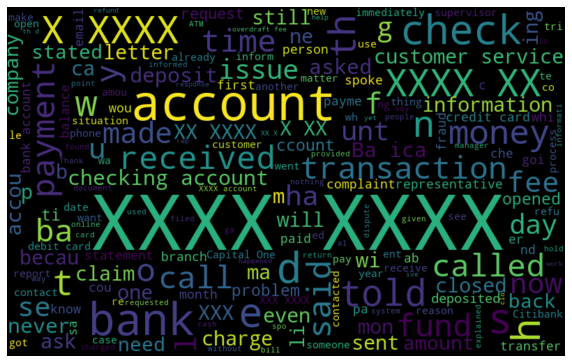

In [ ]:
word_cloud(cluster_df,0)

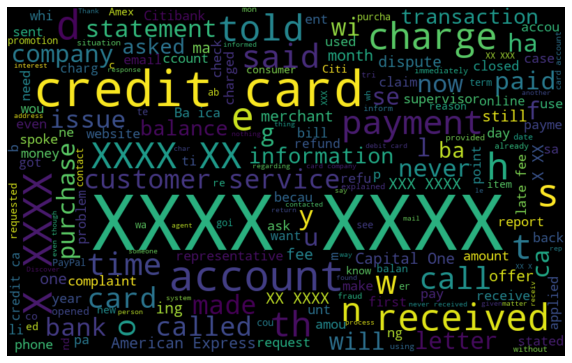

In [ ]:
word_cloud(cluster_df,1)

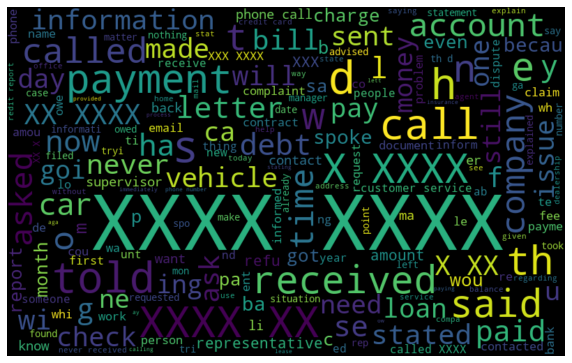

In [ ]:
word_cloud(cluster_df,2)

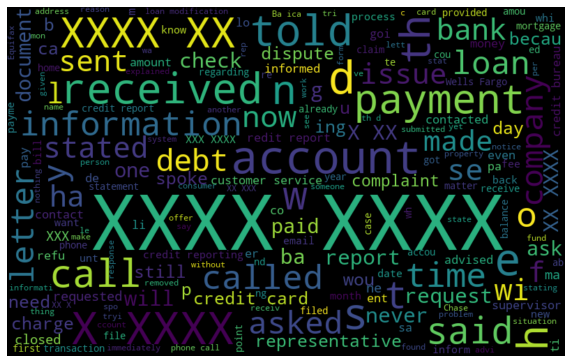

In [ ]:
word_cloud(cluster_df,3)

In [ ]:
from sklearn.metrics import silhouette_score

In [ ]:
labels = clustering_model.labels_
silhouette_score(corpus_embeddings, labels, metric = 'euclidean')

0.038923804

In [ ]:
from sklearn.cluster import DBSCAN

In [ ]:
# Computing 200th Nearest neighbour distance
minPts = 2 * 100
# Lower bound function copied from -> https://gist.github.com/m00nlight/0f9306b4d4e61ba0195f
def lower_bound(nums, target): # This function return the number in the array just greater than or equal to itself.
    l, r = 0, len(nums) - 1
    while l <= r: # Binary searching.
        mid = int(l + (r - l) / 2)
        if nums[mid] >= target:
            r = mid - 1
        else:
            l = mid + 1
    return l

def compute200thnearestneighbour(x, data): # Returns the distance of 200th nearest neighbour.
    dists = []
    for val in data:
      dist = np.sum((x - val) **2 ) # computing distances.
      if(len(dists) == 200 and dists[199] > dist): # If distance is larger than current largest distance found.
            l = int(lower_bound(dists, dist)) # Using the lower bound function to get the right position.
            if l < 200 and l >= 0 and dists[l] > dist:
                dists[l] = dist
      else:
            dists.append(dist)
            dists.sort()
    
    return dists[199] # Dist 199 contains the distance of 200th nearest neighbour.

In [ ]:
# Computing the 200th nearest neighbour distance of some point the dataset:
twohundrethneigh = []
for val in corpus_embeddings[:1500]:
    twohundrethneigh.append( compute200thnearestneighbour(val, corpus_embeddings[:1500]) )
twohundrethneigh.sort()

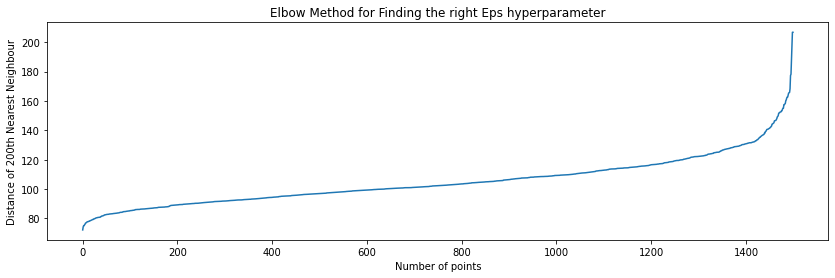

In [ ]:
# Plotting for the Elbow Method :
plt.figure(figsize=(14,4))
plt.title("Elbow Method for Finding the right Eps hyperparameter")
plt.plot([x for x in range(len(twohundrethneigh))], twohundrethneigh)
plt.xlabel("Number of points")
plt.ylabel("Distance of 200th Nearest Neighbour")
plt.show()

In [ ]:
# Training DBSCAN :
model = DBSCAN(eps = 100, min_samples = minPts, n_jobs=-1)
model.fit(corpus_embeddings)

In [ ]:
dfdb = dfa
dfdb['AVG-W2V Clus Label'] = model.labels_
dfdb.head(2)

In [ ]:
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(train["text"])

In [ ]:
X

<70340x91322 sparse matrix of type '<class 'numpy.float64'>'
	with 8660037 stored elements in Compressed Sparse Row format>

In [ ]:
number_of_clusters = 4

# https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html
model = KMeans(n_clusters=number_of_clusters, 
               init='k-means++', 
               max_iter=100, # Maximum number of iterations of the k-means algorithm for a single run.
               n_init=20)  # Number of time the k-means algorithm will be run with different centroid seeds. The final results will be the best output of n_init consecutive runs in terms of inertia.

model.fit(X)

KMeans(max_iter=100, n_clusters=4, n_init=20)

In [ ]:
order_centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
for i in range(number_of_clusters):
    print("Cluster %d:" % i),
    for ind in order_centroids[i, :15]:
        print(' %s' % terms[ind])

Cluster 0:
 fargo
 wells
 xxxx
 far
 mortgage
 loan
 home
 th
 modification
 xx
 payment
 bank
 payments
 xxx
 account
Cluster 1:
 xxxx
 xx
 xxx
 credit
 account
 th
 report
 debt
 loan
 payment
 received
 information
 letter
 mortgage
 collection
Cluster 2:
 xxxx
 debt
 credit
 report
 reporting
 information
 account
 collection
 consumer
 th
 redit
 accounts
 agency
 informati
 equifax
Cluster 3:
 xxxx
 th
 payment
 card
 loan
 xx
 credit
 mortgage
 account
 xxx
 told
 did
 called
 received
 payments


In [ ]:
X1 = vectorizer.transform([train["text"][400]])

cluster = model.predict(X1)[0]

print("Text belongs to cluster number {0}".format(cluster))

Text belongs to cluster number 3


In [ ]:
model.labels_

array([2, 1, 2, ..., 3, 2, 3], dtype=int32)

In [ ]:
model.inertia_

62891.86110610256

In [ ]:
labels = model.labels_
silhouette_score(X, labels, metric = 'euclidean')

0.0065940525888484175

In [ ]:
for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters)
    preds = clusterer.fit_predict(df)
    centers = clusterer.cluster_centers_

    score = silhouette_score(df, preds)
    print("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))

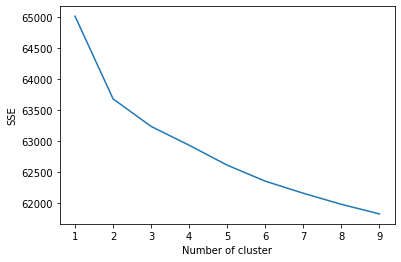

In [ ]:
sse = {}
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k,init='k-means++', max_iter=100,n_init=10).fit(X)
    train["clusters"] = kmeans.labels_
    #print(data["clusters"])
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.show()

In [ ]:
train

,text,label,encoded_label,clusters
0,The reason f i nform you that this compa g unr...,"Credit reporting, credit repair services, or o...",1,8
1,YOUR COMPLAINT uting the debt ow ct Portfolio ...,Debt collection,2,5
2,Theres al curate information constantly report...,"Credit reporting, credit repair services, or o...",1,8
3,called Rushmore Loan Management Services for...,Debt collection,2,7
4,I contacted transunion and XXXX abo unt list ...,"Credit reporting, credit repair services, or o...",1,2
...,...,...,...,...
95527,i opened XXXX Ba ica credit car ears ago and t...,Credit card or prepaid card,0,0
95529,Our XXXX account a l account were breached and...,"Credit reporting, credit repair services, or o...",1,8
95531,I have a American Express card where they are ...,Credit card or prepaid card,0,0
95532,The option I needed under false statemen esent...,Debt collection,2,3


In [ ]:
for ind in order_centroids[cluster, :15]:
    print(' %s' % terms[ind])

 xxxx
 th
 payment
 card
 loan
 xx
 credit
 mortgage
 account
 xxx
 told
 did
 called
 received
 payments


In [ ]:
train.reset_index(inplace=True,drop=True)

In [ ]:
train

,text,label,encoded_label
0,The reason for my writing is to inform you tha...,"Credit reporting, credit repair services, or o...",1
1,YOUR COMPLAINT I am disputing the debt owed to...,Debt collection,2
2,Theres alot of inaccurate information constant...,"Credit reporting, credit repair services, or o...",1
3,XX XX XXXX called Rushmore Loan Management Ser...,Debt collection,2
4,I contacted transunion and XXXX about an accou...,"Credit reporting, credit repair services, or o...",1
...,...,...,...
70335,i opened XXXX Bank of America credit cards 15 ...,Credit card or prepaid card,0
70336,Our XXXX account and an email account were bre...,"Credit reporting, credit repair services, or o...",1
70337,I have a American Express card where they are ...,Credit card or prepaid card,0
70338,The option I needed under false statements or ...,Debt collection,2


In [ ]:
# from sklearn.model_selection import train_test_split
# train, val = train_test_split(train, test_size=0.2, random_state=35)
# train.head()

In [ ]:
# train, validate, test = np.split(train.sample(frac=1, random_state=42), 
#                        [int(.8*len(train)), int(.9*len(train))])

In [ ]:
X=train["text"]
y=train["encoded_label"]

In [ ]:
X.head(10)

0    The reason for my writing is to inform you tha...
1    YOUR COMPLAINT I am disputing the debt owed to...
2    Theres alot of inaccurate information constant...
3    XX XX XXXX called Rushmore Loan Management Ser...
4    I contacted transunion and XXXX about an accou...
5    XXXX XXXX XXXX XXXX XXXX DOB XX XX XXXX ADDRES...
6    Loan orginated in XXXX It was a heloc with 650...
7    The reason I am writing to you is to state tha...
8    I am corresponding about my XXXX XXXX XXXX whi...
9    I had placed a dispute with all credit bureaus...
Name: text, dtype: object

In [ ]:
# import sklearn.model_selection.train_test_split
from sklearn.model_selection import train_test_split

In [ ]:
from sklearn.model_selection import StratifiedShuffleSplit

# Assume `X` and `y` are the feature matrix and target vector respectively
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.1, random_state=42)
for train_index, test_index in sss.split(X, y):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

# To have the validation set
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)


In [ ]:
# X_train, X_test, y_train, y_test = train_test_split(train["text"], train["label"], test_size=0.1, random_state=0, stratify=train["label"])


In [ ]:
# X_train,X_val,y_train,y_val=train_test_split(X_train,y_train,test_size=0.1,random_state=0,stratify=y_train)

In [ ]:
train=pd.concat([X_train,y_train],axis=1)

In [ ]:
test=pd.concat([X_test,y_test],axis=1)

In [ ]:
validate=pd.concat([X_val,y_val],axis=1)

In [ ]:
train.reset_index(drop=True, inplace=True)
train.head(2)

,text,encoded_label
0,Multiple wrong phone calls made with an auto d...,2
1,I m writing because I am veteran with a VA hom...,3


In [ ]:
validate.reset_index(drop=True, inplace=True)
validate.head(2)

,text,encoded_label
0,My loan was sold to a different servicer I set...,3
1,Over the past six months I have been experienc...,0


In [ ]:
test.reset_index(drop=True, inplace=True)
test.head(2)

,text,encoded_label
0,In XXXX XXXX I received a general credit card ...,0
1,XX XX XXXX Complaint Against XXXX and Transuni...,1


In [ ]:
test.shape,validate.shape, train.shape

((7034, 2), (6331, 2), (56975, 2))

In [ ]:
test_100=test.sample(n = 100, random_state = 2)

In [ ]:
test_100.reset_index(inplace=True,drop=True)

In [ ]:
test_100.head(5)

,text,encoded_label
0,On or about XXXX XXXX 2016 I received an offer...,3
1,I received a call on XXXX XXXX from a company ...,2
2,My complaint is toward Bank of America My frie...,3
3,I have disputed a collection account with XXXX...,1
4,On XXXX XXXX 2015 I ordered a XXXX for a XX XX...,0


In [ ]:
# this will replace "Boston Celtics" with "Omega Warrior"
test_100["label"]=test_100["encoded_label"].replace(to_replace=0,value="Credit card or prepaid card",inplace=True)
test_100["label"]=test_100["encoded_label"].replace(to_replace=1,value="Credit reporting, credit repair services, or other personal consumer reports",inplace=True)
test_100["label"]=test_100["encoded_label"].replace(to_replace=2,value="Debt collection",inplace=True)
test_100["label"]=test_100["encoded_label"].replace(to_replace=3,value="Mortgage",inplace=True)
# data.replace({
#     'column_name': {
#         'value_to_replace': 'replace_value_with_this'
#     }
# })
#"Mortgage3","Credit reporting, credit repair services, or other personal consumer reports1","Debt collection2","Credit card or prepaid card0"]


In [ ]:
test_100

,text,encoded_label,label
0,On or about XXXX XXXX 2016 I received an offer...,Mortgage,None
1,I received a call on XXXX XXXX from a company ...,Debt collection,None
2,My complaint is toward Bank of America My frie...,Mortgage,None
3,I have disputed a collection account with XXXX...,"Credit reporting, credit repair services, or o...",None
4,On XXXX XXXX 2015 I ordered a XXXX for a XX XX...,Credit card or prepaid card,None
...,...,...,...
95,I am so XXXX sick of this SCAM Experian is pla...,"Credit reporting, credit repair services, or o...",None
96,Prior to making some overseas trips I consulte...,Credit card or prepaid card,None
97,I have made repeated requests to have the PMI ...,Mortgage,None
98,I have a series of 4 paid student collection a...,"Credit reporting, credit repair services, or o...",None


In [ ]:
test_100["text"][0]

'On or about XXXX XXXX 2016 I received an offer from JP Morgan Chase to refinance my existing mortgage loan with XXXX closing costs to me and a lower interest rate After discussing the offer the refinancing process and terms with a Chase representative on the phone I completed the initial loan processing package and returned the documents to the Chase representative via email One of the documents I completed was Exhibit A Escrow Account Notice where I chose the option to have the funds in my existing escrow account returned to me My understanding of this option meant that I would a establish the required balances of the tax and insurance escrow accounts for the new loan from cash that I would provide at closing and b once the old loan was paid off with funds from the new loan i e none of the old loan escrows would be applied to the payoff the tax and insurance escrow account balances from the old loan would be refunded to me Essentially I would be funding the new loan escrows but would

In [ ]:
actual_label=test_100["encoded_label"].tolist()

In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from transformers import pipeline
from pylab import rcParams
import json
from tqdm import tqdm

In [ ]:
zero_shot_classifier = pipeline("zero-shot-classification",model="facebook/bart-large-mnli")

In [ ]:
Predicted_label=[]
Predicted_score=[]
candidate_labels = ["Mortgage","Credit reporting, credit repair services, or other personal consumer reports","Debt collection","Credit card or prepaid card"] 
for i in test_100["text"]:
    res = zero_shot_classifier(i, candidate_labels, multi_label=True)#setting multi-class as True
    labels = res['labels'] 
    scores = res['scores']
    #print(labels[0])
    # print(labels)
    # print(scores)
    Predicted_label.append(labels[0])
    Predicted_score.append(scores[0])




In [ ]:
test_100["predicted_label"]=pd.DataFrame(Predicted_label)
test_100["predicted_score"]=pd.DataFrame(Predicted_score)

In [ ]:
test_100

,text,encoded_label,label,predicted_label,predicted_score
0,On or about XXXX XXXX 2016 I received an offer...,Mortgage,None,Mortgage,0.994453
1,I received a call on XXXX XXXX from a company ...,Debt collection,None,Debt collection,0.990927
2,My complaint is toward Bank of America My frie...,Mortgage,None,Credit card or prepaid card,0.428603
3,I have disputed a collection account with XXXX...,"Credit reporting, credit repair services, or o...",None,"Credit reporting, credit repair services, or o...",0.990007
4,On XXXX XXXX 2015 I ordered a XXXX for a XX XX...,Credit card or prepaid card,None,Credit card or prepaid card,0.981910
...,...,...,...,...,...
95,I am so XXXX sick of this SCAM Experian is pla...,"Credit reporting, credit repair services, or o...",None,"Credit reporting, credit repair services, or o...",0.999489
96,Prior to making some overseas trips I consulte...,Credit card or prepaid card,None,Credit card or prepaid card,0.958382
97,I have made repeated requests to have the PMI ...,Mortgage,None,Mortgage,0.992940
98,I have a series of 4 paid student collection a...,"Credit reporting, credit repair services, or o...",None,Debt collection,0.989571


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

labels=actual_label
predictions=Predicted_label
# Compute evaluation metrics
acc = accuracy_score(labels, predictions)
prec = precision_score(labels, predictions, average='weighted')
rec = recall_score(labels, predictions, average='weighted')
f1 = f1_score(labels, predictions, average='weighted')

print("Accuracy: ", acc)
print("Precision: ", prec)
print("Recall: ", rec)
print("F1-score: ", f1)


Accuracy:  0.67
Precision:  0.7128661113568235
Recall:  0.67
F1-score:  0.6764771187470855


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(labels, predictions))


                                                                              precision    recall  f1-score   support

                                                 Credit card or prepaid card       0.79      0.56      0.65        27
Credit reporting, credit repair services, or other personal consumer reports       0.47      0.77      0.59        22
                                                             Debt collection       0.71      0.60      0.65        20
                                                                    Mortgage       0.82      0.74      0.78        31

                                                                    accuracy                           0.67       100
                                                                   macro avg       0.70      0.67      0.67       100
                                                                weighted avg       0.71      0.67      0.68       100



In [ ]:
!pip install -q torch torchvision

In [ ]:
# load the sentence-bert model from the HuggingFace model hub
from transformers import AutoTokenizer, AutoModel
from torch.nn import functional as F
tokenizer = AutoTokenizer.from_pretrained('deepset/sentence_bert')
model1 = AutoModel.from_pretrained('deepset/sentence_bert')

Some weights of the model checkpoint at deepset/sentence_bert were not used when initializing BertModel: ['classifier.weight', 'classifier.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
# sentence = 'I have written to the Bureau a total of 4 times I have stated I had no acknowledgment of this account and was asking for documentation for validation As of the Fair Credit Act Section 609 the creditor must provide a signed document with my physical signature If they have said document I would go about that process as necessary Every letter I have written the credit bureaus state they have been verified by Our Company Meaning the bureau Within my rights of Federal Law section 609 a 1 a states they must provide me with a form of verification They have not done so Who has verified my account how was it verified where is my copy of the document I have been punished for an account I have no acknowledgment on They continue to sweep this under the rug and it is not right They are breaking Federal Law by not complying with what is being asked They have also written that if I do nt have any more documentation that they will no longer investigate Im sorry but that is unacceptable Not ONE account that was listed was verified shown form of verification not updated or taken off my credit report I have done everything the proper way I have informed them if they continued to not comply I was going to use my rights and use litigation and get monetary damages under FCRA section 616 section 617 '
labels = ["Mortgage","Credit reporting, credit repair services, or other personal consumer reports","Debt collection","Credit card or prepaid card"]

# run inputs through model and mean-pool over the sequence
# dimension to get sequence-level representations
Predicted_label=[]
Predicted_score=[]
# candidate_labels = ["Mortgage","Credit reporting, credit repair services, or other personal consumer reports","Debt collection","Credit card or prepaid card"] 
for i in test_100["text"]:
    inputs = tokenizer.batch_encode_plus([i] + labels,add_special_tokens=True,return_attention_mask=True,padding='longest',return_tensors='pt',
                                         max_length=512,truncation=True,pad_to_max_length=True)
    #tokenizer.batch_encode_plus(     df.abstract.values,      add_special_tokens=True,      return_attention_mask=True,      padding='longest',     max_length=256,     return_tensors='pt' )
    input_ids = inputs['input_ids']
    attention_mask = inputs['attention_mask']
    output = model1(input_ids, attention_mask=attention_mask)[0]
    sentence_rep = output[:1].mean(dim=1)
    label_reps = output[1:].mean(dim=1)

    # now find the labels with the highest cosine similarities to
    # the sentence
    similarities = F.cosine_similarity(sentence_rep, label_reps)
    closest = similarities.argsort(descending=True)
    ind=closest[0]
    Pred_label=labels[ind]
    Predicted_label.append(Pred_label)

# for ind in closest:
#     print(f'label: {labels[ind]} \t similarity: {similarities[ind]}')

In [ ]:
len(Predicted_label)

100

In [ ]:
test_100["predicted_label_sentbert"]=pd.DataFrame(Predicted_label)
#test_100["predicted_score"]=pd.DataFrame(Predicted_score)

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

labels=actual_label
predictions=Predicted_label
# Compute evaluation metrics
acc = accuracy_score(labels, predictions)
prec = precision_score(labels, predictions, average='weighted')
rec = recall_score(labels, predictions, average='weighted')
f1 = f1_score(labels, predictions, average='weighted')

print("Accuracy: ", acc)
print("Precision: ", prec)
print("Recall: ", rec)
print("F1-score: ", f1)


Accuracy:  0.41
Precision:  0.7235733695652175
Recall:  0.41
F1-score:  0.3805525642494368


In [ ]:
ind=closest[0]

In [ ]:
labels[ind]

'Credit reporting, credit repair services, or other personal consumer reports'

In [ ]:
sr=similarities.sort()

In [ ]:
cosine_value=sr[0][-1]

In [ ]:
cosine_value

tensor(0.2070, grad_fn=<SelectBackward0>)

In [ ]:
from datasets import Dataset
import datasets

In [ ]:
train_dataset = Dataset.from_dict(train)
val_dataset = Dataset.from_dict(validate)
test_dataset= Dataset.from_dict(test)
my_dataset_dict = datasets.DatasetDict({"train":train_dataset,"val":val_dataset,"test":test_dataset})

In [ ]:
candidate_labels = ["Mortgage","Credit reporting, credit repair services, or other personal consumer reports","Debt collection","Credit card or prepaid card"] 
#candidate labels are basically the classes that the classifier will predict
predictedCategories = []
trueCategories = []
for i in tqdm(range(100)):
    text = train_raw.iloc[i,]['text']
    cat = train_raw.iloc[i,]['label']
    #cat = cat.split()
    res = zero_shot_classifier(text, candidate_labels, multi_label=True)#setting multi-class as True
    labels = res['labels'] 
    scores = res['scores'] #extracting the scores associated with the labels
    res_dict = {label : score for label,score in zip(labels, scores)}
    sorted_dict = dict(sorted(res_dict.items(), key=lambda x:x[1],reverse = True)) #sorting the dictionary of labels in descending order based on their score
    categories  = []
    # for i, (k,v) in enumerate(sorted_dict.items()):
    #     if(i > 2): #storing only the best 3 predictions
    #           break
    #     else:
    #           categories.append(k)
    # predictedCategories.append(categories)
    # trueCats = [train_raw[x] for x in cat]
    # trueCategories.append(trueCats)

100%|██████████| 100/100 [50:20<00:00, 30.21s/it]


In [ ]:
my_dataset_dict

DatasetDict({
    train: Dataset({
        features: ['text', 'label'],
        num_rows: 89901
    })
    val: Dataset({
        features: ['text', 'label'],
        num_rows: 9989
    })
    test: Dataset({
        features: ['text', 'label'],
        num_rows: 11099
    })
})

In [ ]:
def label_int2str(x):
    return my_dataset_dict["train"].features["label"].int2str(x)

In [ ]:
my_dataset_dict["train"]["text"]

['I have written to the Bureau a total of 4 times I have stated I had no acknowledgment of this account and was asking for documentation for validation As of the Fair Credit Act Section 609 the creditor must provide a signed document with my physical signature If they have said document I would go about that process as necessary Every letter I have written the credit bureaus state they have been verified by Our Company Meaning the bureau Within my rights of Federal Law section 609 a 1 a states they must provide me with a form of verification They have not done so Who has verified my account how was it verified where is my copy of the document I have been punished for an account I have no acknowledgment on They continue to sweep this under the rug and it is not right They are breaking Federal Law by not complying with what is being asked They have also written that if I do nt have any more documentation that they will no longer investigate Im sorry but that is unacceptable Not ONE accou

In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 45.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 121.0 MB/s eta 0:00:00


In [ ]:
from transformers import AutoTokenizer
model_ckpt = "distilbert-base-uncased"
tokenizer = AutoTokenizer.from_pretrained(pretrained_model_name_or_path=model_ckpt)

In [ ]:
print(f"Vocab size is : {tokenizer.vocab_size}")
print(f"Model max length is : {tokenizer.model_max_length}")
print(f"Model input names are: {tokenizer.model_input_names}")

Vocab size is : 30522
Model max length is : 512
Model input names are: ['input_ids', 'attention_mask']


In [ ]:
# Tokenization function
def tokenize(batch):
    return tokenizer(batch["text"], padding=True, truncation=True)
# Tokenize entire dataset 
tokenized_dataset = my_dataset_dict.map(tokenize, batched=True, batch_size=None)

  0%|          | 0/1 [00:00<?, ?ba/s]

  0%|          | 0/1 [00:00<?, ?ba/s]

  0%|          | 0/1 [00:00<?, ?ba/s]

In [ ]:
tokenized_dataset

DatasetDict({
    train: Dataset({
        features: ['text', 'label', 'input_ids', 'attention_mask'],
        num_rows: 89901
    })
    val: Dataset({
        features: ['text', 'label', 'input_ids', 'attention_mask'],
        num_rows: 9989
    })
    test: Dataset({
        features: ['text', 'label', 'input_ids', 'attention_mask'],
        num_rows: 11099
    })
})

In [ ]:
# oversample = SMOTE(tokenized_dataset["train"]["input_ids"],random_state=777,k_neighbors=5)
# X_smote,y_smote = oversample.fit_resample(X,tokenized_dataset["train"]["label"])
# # oversample = SMOTE()
# # X, y = oversample.fit_resample(X, y)

In [ ]:
train["label"].value_counts()

12    27559
6      8051
31     7719
38     5724
32     5479
17     3543
30     2682
21     2651
41     2370
16     2308
4      2302
39     2093
20     1971
10     1885
37     1641
33     1143
35      929
34      770
24      713
15      660
23      608
40      567
2       566
28      565
27      527
13      492
3       478
7       443
22      409
25      374
26      347
19      341
36      329
14      295
29      289
5       280
18      174
11      144
0       141
1       132
9       109
8        98
Name: label, dtype: int64

In [ ]:
from transformers import TFAutoModelForSequenceClassification
num_labels = 42
model = TFAutoModelForSequenceClassification.from_pretrained(model_ckpt, 
                                                             num_labels=num_labels)

Some layers from the model checkpoint at distilbert-base-uncased were not used when initializing TFDistilBertForSequenceClassification: ['vocab_transform', 'vocab_layer_norm', 'vocab_projector', 'activation_13']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some layers of TFDistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier', 'pre_classifier', 'dropout_19']
You should probably TRAIN this model on a down-stream task to be able to use i

In [ ]:
batch_size=16
from transformers import DataCollatorWithPadding
data_collator = DataCollatorWithPadding(tokenizer=tokenizer, return_tensors="tf")

In [ ]:
!pip install datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#tf_dataset = model.prepare_tf_dataset(tokenized_dataset_train, batch_size=16, shuffle=True, tokenizer=tokenizer)

In [ ]:
tf_train_dataset = tokenized_dataset["train"].to_tf_dataset(
    columns=["input_ids","attention_mask"], 
    label_cols=["label"], 
    shuffle=True, 
    batch_size=batch_size,
    collate_fn=data_collator
)
tf_valid_dataset = tokenized_dataset["val"].to_tf_dataset(
    columns=["input_ids", "attention_mask"], 
    label_cols=["label"], 
    shuffle=False, 
    batch_size=batch_size,
    collate_fn=data_collator
)
tf_test_dataset = tokenized_dataset["test"].to_tf_dataset(
    columns=["input_ids", "attention_mask"], 
    label_cols=["label"], 
    shuffle=False, 
    batch_size=batch_size,
    collate_fn=data_collator
)

You're using a DistilBertTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


In [ ]:
tf_train_dataset

<PrefetchDataset element_spec=({'input_ids': TensorSpec(shape=(None, 512), dtype=tf.int64, name=None), 'attention_mask': TensorSpec(shape=(None, 512), dtype=tf.int64, name=None)}, TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [ ]:
model.compile(
    optimizer=optimizers.Adam(learning_rate=5e-5),
    loss=losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=metrics.SparseCategoricalAccuracy()
)

In [ ]:
model.fit(tf_train_dataset, 
          validation_data=tf_valid_dataset, 
          epochs=1,
          class_weight=class_weights)

5619/5619 [==============================] - 5367s 952ms/step - loss: 2.0983 - sparse_categorical_accuracy: 0.2774 - val_loss: 1.7736 - val_sparse_categorical_accuracy: 0.4004


In [ ]:
model.save_weights("/content/gdrive/MyDrive/Colab Notebooks/textclassification(subclass)_hf_Strat1.h5")

In [ ]:
from keras.models import load_model

In [ ]:
from tensorflow.keras import Model

In [ ]:
model.load_weights("/content/gdrive/MyDrive/Colab Notebooks/textclassification(subclass)_hf_Strat1.h5")

NameError: ignored

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
prediction = model.predict(tf_test_dataset)

694/694 [==============================] - 215s 308ms/step


In [ ]:
predictions = np.argmax(prediction["logits"], axis=1)

NameError: ignored

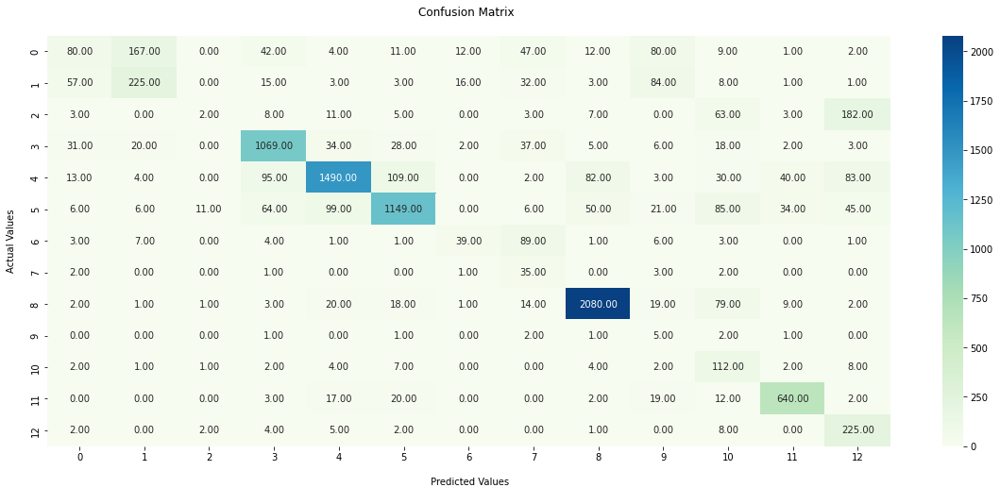

In [ ]:
from sklearn.metrics import confusion_matrix
plt.figure(figsize=(20,8))
fx=sns.heatmap(confusion_matrix(labels, predictions), annot=True, fmt=".2f",cmap="GnBu")
fx.set_title('Confusion Matrix \n');
fx.set_xlabel('\n Predicted Values\n')
fx.set_ylabel('Actual Values\n');
plt.show()

In [ ]:
outputs = model.predict(tokenizer("I am sure i will do well in my exam.")["input_ids"])
outputs['logits'][0].tolist()

1/1 [==============================] - 2s 2s/step


[-0.7169638276100159,
 -0.0678609311580658,
 -1.2969688177108765,
 0.4881438612937927,
 0.04243877902626991,
 0.7089837789535522,
 -1.231553077697754,
 -2.7957847118377686,
 -0.46948179602622986,
 -1.7305536270141602,
 -1.2575603723526,
 1.2621546983718872,
 -1.0060926675796509]

In [ ]:
!pip install evaluate

In [ ]:
import evaluate

accuracy = evaluate.load("accuracy")

In [ ]:
accuracy_result = accuracy.compute(references=tokenized_dataset["test"]["label"], predictions=predictions)

In [ ]:
accuracy_result

{'accuracy': 0.8319028679087294}

In [ ]:
import numpy as np
label_int = np.argmax(tf.keras.layers.Softmax()(outputs['logits'][0].tolist()))
print(label_int.item())

11


In [ ]:
print(label_int2str(label_int.item()))

In [ ]:
# load the sentence-bert model from the HuggingFace model hub
!pip install transformers
from transformers import AutoTokenizer, AutoModel
from torch.nn import functional as F
tokenizer = AutoTokenizer.from_pretrained('deepset/sentence_bert')
model = AutoModel.from_pretrained('deepset/sentence_bert')

sentence = 'Who are you voting for in 2020?'
labels = ['business', 'art & culture', 'politics']

# run inputs through model and mean-pool over the sequence
# dimension to get sequence-level representations
inputs = tokenizer.batch_encode_plus([sentence] + labels,
                                     return_tensors='pt',
                                     pad_to_max_length=True)
input_ids = inputs['input_ids']
attention_mask = inputs['attention_mask']
output = model(input_ids, attention_mask=attention_mask)[0]
sentence_rep = output[:1].mean(dim=1)
label_reps = output[1:].mean(dim=1)

# now find the labels with the highest cosine similarities to
# the sentence
similarities = F.cosine_similarity(sentence_rep, label_reps)
closest = similarities.argsort(descending=True)
for ind in closest:
    print(f'label: {labels[ind]} \t similarity: {similarities[ind]}')
     

In [ ]:
#Installing BERT module
!pip install bert-tensorflow

In [ ]:
!pip uninstall tensorflow_estimator
 # pip install tensorflow_estimator

In [ ]:
#Importing BERT modules
import bert
from bert import run_classifier
from bert import optimization
from bert import tokenization

# Setting The Output Directory for BERT

In [ ]:
# Set the output directory for saving model file
OUTPUT_DIR = '/bert_news_category'

#@markdown Whether or not to clear/delete the directory and create a new one
DO_DELETE = True #@param {type:"boolean"}

if DO_DELETE:
  try:
    tf.gfile.DeleteRecursively(OUTPUT_DIR)
  except:
    pass

tf.gfile.MakeDirs(OUTPUT_DIR)
print('***** Model output directory: {} *****'.format(OUTPUT_DIR))

In [ ]:
print("Training Set Shape :", train.shape)
print("Validation Set Shape :", val.shape)
# print("Test Set Shape :", test.shape)

In [ ]:
DATA_COLUMN = 'text'
LABEL_COLUMN = 'label'
# The list containing all the classes (train['SECTION'].unique())
label_list = [x for x in np.unique(train.label)]
label_list

# Splitting the Data into smaller chunks

In [ ]:
def get_split(text1):
  l_total = []
  l_parcial = []
  if len(text1.split())//150 >0:
    n = len(text1.split())//150
  else: 
    n = 1
  for w in range(n):
    if w == 0:
      l_parcial = text1.split()[:200]
      l_total.append(" ".join(l_parcial))
    else:
      l_parcial = text1.split()[w*150:w*150 + 200]
      l_total.append(" ".join(l_parcial))
  return l_total

In [ ]:
train['text_split'] = train[DATA_COLUMN].apply(get_split)
train.head()

In [ ]:
val['text_split'] = val[DATA_COLUMN].apply(get_split)
val.head(2)

In [ ]:
train_l = []
label_l = []
index_l =[]
for idx,row in train.iterrows():
  for l in row['text_split']:
    train_l.append(l)
    label_l.append(row['label'])
    index_l.append(idx)
len(train_l), len(label_l), len(index_l)

In [ ]:
val_l = []
val_label_l = []
val_index_l = []
for idx,row in val.iterrows():
  for l in row['text_split']:
    val_l.append(l)
    val_label_l.append(row['label'])
    val_index_l.append(idx)
len(val_l), len(val_label_l), len(val_index_l)

The final dataset for training:

In [ ]:
train_df = pd.DataFrame({DATA_COLUMN:train_l, LABEL_COLUMN:label_l})
train_df.head()

In [ ]:
val_df = pd.DataFrame({DATA_COLUMN:val_l, LABEL_COLUMN:val_label_l})
val_df.head()

# BERT: Data Preprocessing 

Process the data for BERT

In [ ]:
train_InputExamples = train_df.apply(lambda x: bert.run_classifier.InputExample(guid=None,
                                                                   text_a = x[DATA_COLUMN], 
                                                                   text_b = None, 
                                                                   label = x[LABEL_COLUMN]), axis = 1)

val_InputExamples = val_df.apply(lambda x: bert.run_classifier.InputExample(guid=None, 
                                                                   text_a = x[DATA_COLUMN], 
                                                                   text_b = None, 
                                                                   label = x[LABEL_COLUMN]), axis = 1)

In [ ]:
train_InputExamples

In [ ]:
print("Row 0 - guid of training set : ", train_InputExamples.iloc[0].guid)
print("\n__________\nRow 0 - text_a of training set : ", train_InputExamples.iloc[0].text_a)
print("\n__________\nRow 0 - text_b of training set : ", train_InputExamples.iloc[0].text_b)
print("\n__________\nRow 0 - label of training set : ", train_InputExamples.iloc[0].label)

# BERT: Loading the pre-trained model

In [ ]:

# This is a path to an uncased (all lowercase) version of BERT
BERT_MODEL_HUB = "https://tfhub.dev/google/bert_uncased_L-12_H-768_A-12/1"

def create_tokenizer_from_hub_module():
  """Get the vocab file and casing info from the Hub module."""
  with tf.Graph().as_default():
    bert_module = hub.Module(BERT_MODEL_HUB)
    tokenization_info = bert_module(signature="tokenization_info", as_dict=True)
    with tf.Session() as sess:
      vocab_file, do_lower_case = sess.run([tokenization_info["vocab_file"],
                                            tokenization_info["do_lower_case"]])
      
  return bert.tokenization.FullTokenizer(
      vocab_file=vocab_file, do_lower_case=do_lower_case)

tokenizer = create_tokenizer_from_hub_module()

In [ ]:
len(tokenizer.vocab.keys())

In [ ]:
#Here is what the tokenised sample of the first training set observation looks like
print(tokenizer.tokenize(train_InputExamples.iloc[0].text_a))

In [ ]:
MAX_SEQ_LENGTH = 200

In [ ]:
# Convert our train and validation features to InputFeatures that BERT understands.
train_features = bert.run_classifier.convert_examples_to_features(train_InputExamples, label_list, MAX_SEQ_LENGTH, tokenizer)

val_features = bert.run_classifier.convert_examples_to_features(val_InputExamples, label_list, MAX_SEQ_LENGTH, tokenizer)

In [ ]:
#Example on first observation in the training set
print("Sentence : ", train_InputExamples.iloc[0].text_a)
print("-"*30)
print("Tokens : ", tokenizer.tokenize(train_InputExamples.iloc[0].text_a))
print("-"*30)
print("Input IDs : ", train_features[0].input_ids)
print("-"*30)
print("Input Masks : ", train_features[0].input_mask)
print("-"*30)
print("Segment IDs : ", train_features[0].segment_ids)

# BERT: Creating A Multi-Class Classifier Model

In [ ]:
def create_model(is_predicting, input_ids, input_mask, segment_ids, labels,
                 num_labels):
  
  bert_module = hub.Module(
      BERT_MODEL_HUB,
      trainable=True)
  bert_inputs = dict(
      input_ids=input_ids,
      input_mask=input_mask,
      segment_ids=segment_ids)
  bert_outputs = bert_module(
      inputs=bert_inputs,
      signature="tokens",
      as_dict=True)

  # Use "pooled_output" for classification tasks on an entire sentence.
  # Use "sequence_outputs" for token-level output.
  output_layer = bert_outputs["pooled_output"]
  # with tf.Session() as sess:
  output_layer1 = bert_outputs["pooled_output"]
  # output_layer1 = 999
  hidden_size = output_layer.shape[-1].value

  # Create our own layer to tune for politeness data.
  output_weights = tf.get_variable(
      "output_weights", [num_labels, hidden_size],
      initializer=tf.truncated_normal_initializer(stddev=0.02))

  output_bias = tf.get_variable(
      "output_bias", [num_labels], initializer=tf.zeros_initializer())

  with tf.variable_scope("loss"):

    # Dropout helps prevent overfitting
    output_layer = tf.nn.dropout(output_layer, keep_prob=0.8)

    logits = tf.matmul(output_layer, output_weights, transpose_b=True)
    logits = tf.nn.bias_add(logits, output_bias)
    log_probs = tf.nn.log_softmax(logits, axis=-1)

    # Convert labels into one-hot encoding
    one_hot_labels = tf.one_hot(labels, depth=num_labels, dtype=tf.float32)

    predicted_labels = tf.squeeze(tf.argmax(log_probs, axis=-1, output_type=tf.int32))
    # If we're predicting, we want predicted labels and the probabiltiies.
    if is_predicting:
      return (predicted_labels, log_probs, output_layer1)

    # If we're train/eval, compute loss between predicted and actual label
    per_example_loss = -tf.reduce_sum(one_hot_labels * log_probs, axis=-1)
    loss = tf.reduce_mean(per_example_loss)
    return (loss, predicted_labels, log_probs)

In [ ]:
def model_fn_builder(num_labels, learning_rate, num_train_steps,
                     num_warmup_steps):
  """Returns `model_fn` closure for TPUEstimator."""
  def model_fn(features, labels, mode, params):  # pylint: disable=unused-argument
    """The `model_fn` for TPUEstimator."""

    input_ids = features["input_ids"]
    input_mask = features["input_mask"]
    segment_ids = features["segment_ids"]
    label_ids = features["label_ids"]

    is_predicting = (mode == tf.estimator.ModeKeys.PREDICT)
    
    # TRAIN and EVAL
    if not is_predicting:

      (loss, predicted_labels, log_probs) = create_model(
        is_predicting, input_ids, input_mask, segment_ids, label_ids, num_labels)

      train_op = bert.optimization.create_optimizer(
          loss, learning_rate, num_train_steps, num_warmup_steps, use_tpu=False)

      # Calculate evaluation metrics. 
      def metric_fn(label_ids, predicted_labels):
        accuracy = tf.metrics.accuracy(label_ids, predicted_labels)
        true_pos = tf.metrics.true_positives(
            label_ids,
            predicted_labels)
        true_neg = tf.metrics.true_negatives(
            label_ids,
            predicted_labels)   
        false_pos = tf.metrics.false_positives(
            label_ids,
            predicted_labels)  
        false_neg = tf.metrics.false_negatives(
            label_ids,
            predicted_labels)
        
        return {
            "eval_accuracy": accuracy,
            "true_positives": true_pos,
            "true_negatives": true_neg,
            "false_positives": false_pos,
            "false_negatives": false_neg,
            }

      eval_metrics = metric_fn(label_ids, predicted_labels)

      if mode == tf.estimator.ModeKeys.TRAIN:
        return tf.estimator.EstimatorSpec(mode=mode,
          loss=loss,
          train_op=train_op)
      else:
          return tf.estimator.EstimatorSpec(mode=mode,
            loss=loss,
            eval_metric_ops=eval_metrics)
    else:
      (predicted_labels, log_probs, output_layer) = create_model(
        is_predicting, input_ids, input_mask, segment_ids, label_ids, num_labels)
      predictions = {
          'probabilities': log_probs,
          'labels': predicted_labels,
          'pooled_output': output_layer
      }
      return tf.estimator.EstimatorSpec(mode, predictions=predictions)

  # Return the actual model function in the closure
  return model_fn

In [ ]:
BATCH_SIZE = 16
LEARNING_RATE = 2e-5
NUM_TRAIN_EPOCHS = 1.0
# Warmup is a period of time where the learning rate is small and gradually increases--usually helps training.
WARMUP_PROPORTION = 0.1
# Model configs
SAVE_CHECKPOINTS_STEPS = 300
SAVE_SUMMARY_STEPS = 100

# Compute train and warmup steps from batch size
num_train_steps = int(len(train_features) / BATCH_SIZE * NUM_TRAIN_EPOCHS)
num_warmup_steps = int(num_train_steps * WARMUP_PROPORTION)

# Specify output directory and number of checkpoint steps to save
run_config = tf.estimator.RunConfig(
    model_dir=OUTPUT_DIR,
    save_summary_steps=SAVE_SUMMARY_STEPS,
    save_checkpoints_steps=SAVE_CHECKPOINTS_STEPS)

# Specify output directory and number of checkpoint steps to save
run_config = tf.estimator.RunConfig(
    model_dir=OUTPUT_DIR,
    save_summary_steps=SAVE_SUMMARY_STEPS,
    save_checkpoints_steps=SAVE_CHECKPOINTS_STEPS)

In [ ]:
num_train_steps, len(label_list)

In [ ]:
#Initializing the model and the estimator
model_fn = model_fn_builder(
  num_labels=len(label_list),
  learning_rate=LEARNING_RATE,
  num_train_steps=num_train_steps,
  num_warmup_steps=num_warmup_steps)

estimator = tf.estimator.Estimator(
  model_fn=model_fn,
  config=run_config,
  params={"batch_size": BATCH_SIZE})


In [ ]:
# Create an input function for training. drop_remainder = True for using TPUs.
train_input_fn = bert.run_classifier.input_fn_builder(
    features=train_features,
    seq_length=MAX_SEQ_LENGTH,
    is_training=True,
    drop_remainder=False)

# Create an input function for validating. drop_remainder = True for using TPUs.
val_input_fn = run_classifier.input_fn_builder(
    features=val_features,
    seq_length=MAX_SEQ_LENGTH,
    is_training=False,
    drop_remainder=False)

# BERT: Fine Tuning Training & Evaluating

In [ ]:
#Training the model
print(f'Beginning Training!')
current_time = datetime.now()
estimator.train(input_fn=train_input_fn, max_steps=num_train_steps)
print("Training took time ", datetime.now() - current_time)

The accuracy for the fine tuned BERT model

In [ ]:
#Evaluating the model with Validation set
estimator.evaluate(input_fn=val_input_fn, steps=None)

# BERT: Get The Vector Transformations from the Fine Tuned BERT

In [ ]:
# A method to get predictions
def getPrediction(in_sentences, type_output = "features"):
  #A list to map the actual labels to the predictions
  labels = np.unique(train['label'])
  input_examples = [run_classifier.InputExample(guid="", text_a = x, text_b = None, label = 0) for x in in_sentences] 
  input_features = run_classifier.convert_examples_to_features(input_examples, label_list, MAX_SEQ_LENGTH, tokenizer)
  #Predicting the classes 
  predict_input_fn = run_classifier.input_fn_builder(features=input_features, seq_length=MAX_SEQ_LENGTH, is_training=False, drop_remainder=False)
  predictions = estimator.predict(predict_input_fn)
  if type_output == "features":
    return [prediction['pooled_output'] for _,prediction in enumerate(predictions) ]
  else:
    return ([(sentence, prediction['probabilities'],
              prediction['labels'], labels[prediction['labels']]) for sentence, prediction in zip(in_sentences, predictions)])


In [ ]:
tf.compat.v1.logging.set_verbosity(tf.logging.ERROR)
MAX_SEQ_LENGTH

In [ ]:
train_df.shape, val_df.shape

Now extracting the representations:

In [ ]:
%%time
tr_emb = np.apply_along_axis(getPrediction, 0,np.array(train_df[DATA_COLUMN]))


In [ ]:
%%time
val_emb = np.apply_along_axis(getPrediction, 0,np.array(val_df[DATA_COLUMN]))
val_emb.shape

In [ ]:
val_emb.shape, tr_emb.shape

and make the dataset for train and val:

In [ ]:
aux = -1
len_l = 0
train_x = {}
for l, emb in zip(index_l, tr_emb):
  if l in train_x.keys():
    train_x[l]  =np.vstack([train_x[l], emb])
  else:
    train_x[l] = [emb]

len(train_x.keys())


In [ ]:
train_l_final = []
label_l_final = []
for k in train_x.keys():
  train_l_final.append(train_x[k])
  label_l_final.append(train.loc[k]['label'])

df_train = pd.DataFrame({'emb': train_l_final, 'label': label_l_final, })
df_train.head()

In [ ]:
aux = -1
len_l = 0
val_x = {}

for l, emb in zip(val_index_l, val_emb):
  if l in val_x.keys():
    val_x[l]  =np.vstack([val_x[l], emb])
  else:
    val_x[l] = [emb]


val_l_final = []
vlabel_l_final = []
for k in val_x.keys():
  val_l_final.append(val_x[k])
  vlabel_l_final.append(val.loc[k]['label'])

df_val = pd.DataFrame({'emb': val_l_final, 'label': vlabel_l_final})
df_val.head()

In [ ]:
df_val, df_test = train_test_split(df_val, test_size=0.4, random_state=35)

# LSTM: Creating the Final Model

In [ ]:
from keras import layers
text_input = Input(shape=(None,768,), dtype='float32', name='text')

l_mask = layers.Masking(mask_value=-99.)(text_input)
# Which we encoded in a single vector via a LSTM
encoded_text = layers.LSTM(100,)(l_mask)
out_dense = layers.Dense(30, activation='relu')(encoded_text)
# And we add a softmax classifier on top
out = layers.Dense(len(label_list), activation='softmax')(out_dense)
# At model instantiation, we specify the input and the output:
model = Model(text_input, out)
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['acc'])
model.summary()

In [ ]:
df_train.shape, df_val.shape, df_test.shape

The generator functions:

In [ ]:
num_sequences = len(df_train['emb'].to_list())
batch_size = 3
batches_per_epoch =  4571
assert batch_size * batches_per_epoch == num_sequences
num_features= 768
def train_generator(df):
    x_list= df['emb'].to_list()
    y_list =  df.label.to_list()
    # Generate batches
    while True:
        for b in range(batches_per_epoch):
            longest_index = (b + 1) * batch_size - 1
            timesteps = len(max(df['emb'].to_list()[:(b + 1) * batch_size][-batch_size:], key=len))
            x_train = np.full((batch_size, timesteps, num_features), -99.)
            y_train = np.zeros((batch_size,  1))
            for i in range(batch_size):
                li = b * batch_size + i
                x_train[i, 0:len(x_list[li]), :] = x_list[li]
                y_train[i] = y_list[li]
            yield x_train, y_train

In [ ]:
num_sequences_val = len(df_val['emb'].to_list())
batch_size_val = 11
batches_per_epoch_val = 187
assert batch_size_val * batches_per_epoch_val == num_sequences_val
num_features= 768
def val_generator(df):
    x_list= df['emb'].to_list()
    y_list =  df.label.to_list()
    # Generate batches
    while True:
        for b in range(batches_per_epoch_val):
            longest_index = (b + 1) * batch_size_val - 1
            timesteps = len(max(df['emb'].to_list()[:(b + 1) * batch_size_val][-31:], key=len))
            # print(len(df_train['emb'].to_list()[:b+batch_size][-7:]))
            x_train = np.full((batch_size_val, timesteps, num_features), -99.)
            y_train = np.zeros((batch_size_val,  1))
            for i in range(batch_size_val):
                li = b * batch_size_val + i
                # print("li", li)
                # print(x_train[i, 0:len(x_list[li]), :].shape, len(x_list[li]))
                x_train[i, 0:len(x_list[li]), :] = x_list[li]
                y_train[i] = y_list[li]
            yield x_train, y_train

# LSTM Final Model: Training

In [ ]:
from keras.callbacks import ReduceLROnPlateau
call_reduce = ReduceLROnPlateau(monitor='val_acc', factor=0.95, patience=3, verbose=2,
                                mode='auto', min_delta=0.01, cooldown=0, min_lr=0)

In [ ]:
model.fit_generator(train_generator(df_train), steps_per_epoch=batches_per_epoch, epochs=10,
                    validation_data=val_generator(df_val), validation_steps=batches_per_epoch_val, callbacks =[call_reduce] )

# LSTM Final Model: Evaluation



In [ ]:
num_sequences_val = len(df_test['emb'].to_list())
batch_size_val = 4
batches_per_epoch_val = 343
assert batch_size_val * batches_per_epoch_val == num_sequences_val
num_features= 768
model.evaluate_generator(val_generator(df_test), steps= batches_per_epoch_val)